# Описание проекта

Имеютсяпробы нефти в трёх регионах: в каждом 10 000 месторождений, где измерили качество нефти и объём её запасов. Необходимо построить модель машинного обучения, которая поможет определить регион, где добыча принесёт наибольшую прибыль. Проанализировать возможную прибыль и риски.

Шаги для выбора локации:

- В избранном регионе ищут месторождения, для каждого определяют значения признаков;
- Строят модель и оценивают объём запасов;
- Выбирают месторождения с самым высокими оценками значений. Количество месторождений зависит от бюджета компании и стоимости разработки одной скважины;
- Прибыль равна суммарной прибыли отобранных месторождений.

## Условия задачи


+ При разведке региона исследуют 500 точек, из которых выбирают 200 лучших для расчёта прибыли.
+ Бюджет на разработку скважин в регионе — 10 млрд рублей.
+ Один баррель сырья приносит 450 рублей дохода. Доход с каждой единицы продукта составляет 450 тыс. рублей, поскольку объём указан в тысячах баррелей.
+ После оценки рисков нужно оставить лишь те регионы, в которых вероятность убытков меньше 2.5%. Среди них выбирают регион с наибольшей средней прибылью.
+ Данные синтетические: детали контрактов и характеристики месторождений не разглашаются.

# Общие данные

## Импортируем библиотеки

In [10]:
# Импортируем библиотеки
# для работы с данными
import pandas as pd
import numpy as np

# # для работы с датой
# import datetime
# from dateutil import relativedelta

# # Для работы со статистикой
from scipy import stats as st

#Предупреждения
import warnings
warnings.filterwarnings('ignore')

#для загрузки данных
from pathlib import Path
import os
import urllib.request

# Для Графиков
import matplotlib.pyplot as plt
import seaborn as sns

import plotly
import plotly.graph_objs as go
import plotly.express as px


#увеличим дефолтный размер графиков
from pylab import rcParams
rcParams['figure.figsize'] = 8, 5

#для построения моделей
from sklearn.linear_model import LinearRegression

from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, cross_validate, cross_val_predict

from sklearn.preprocessing import StandardScaler

## Загрузим данные

In [11]:
#Cоздадим папку если ее нет
Path('datasets').mkdir(parents=True, exist_ok=True)

#словарь с именем файла и ссылкой на него
urls = {
    'geo_data_0': ('datasets/geo_data_0.csv', '.../datasets/geo_data_0.csv'),
    'geo_data_1': ('datasets/geo_data_1.csv', '.../datasets/geo_data_1.csv'),
    'geo_data_2': ('datasets/geo_data_2.csv', '.../datasets/geo_data_2.csv')
}

def get_file(file_name, url):
    #Проверим есть ли файл
    if not os.path.exists(file_name):
        print(file_name, 'файл не найден, будет загружен из сети')
        #качаем файл по ссылке url, кладем по пути file_name
        _ = urllib.request.urlretrieve(url, file_name)

[get_file(*urls[k]) for k in urls]
     
data_0 = pd.read_csv(urls['geo_data_0'][0])
data_1 = pd.read_csv(urls['geo_data_1'][0])
data_2 = pd.read_csv(urls['geo_data_2'][0])

datasets/geo_data_0.csv файл не найден, будет загружен из сети
datasets/geo_data_1.csv файл не найден, будет загружен из сети
datasets/geo_data_2.csv файл не найден, будет загружен из сети


# 1. Подготовка данных

## 1.1. Проверим данные

In [12]:
data_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


In [13]:
data_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


In [14]:
data_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   id       100000 non-null  object 
 1   f0       100000 non-null  float64
 2   f1       100000 non-null  float64
 3   f2       100000 non-null  float64
 4   product  100000 non-null  float64
dtypes: float64(4), object(1)
memory usage: 3.8+ MB


In [15]:
data_0.describe()

,f0,f1,f2,product
count,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.500419,0.250143,2.502647,92.500000
std,0.871832,0.504433,3.248248,44.288691
min,-1.408605,-0.848218,-12.088328,0.000000
25%,-0.072580,-0.200881,0.287748,56.497507
50%,0.502360,0.250252,2.515969,91.849972
75%,1.073581,0.700646,4.715088,128.564089
max,2.362331,1.343769,16.003790,185.364347


In [16]:
data_1.describe()

,f0,f1,f2,product
count,100000.000000,100000.000000,100000.000000,100000.000000
mean,1.141296,-4.796579,2.494541,68.825000
std,8.965932,5.119872,1.703572,45.944423
min,-31.609576,-26.358598,-0.018144,0.000000
25%,-6.298551,-8.267985,1.000021,26.953261
50%,1.153055,-4.813172,2.011479,57.085625
75%,8.621015,-1.332816,3.999904,107.813044
max,29.421755,18.734063,5.019721,137.945408


In [17]:
data_2.describe()

,f0,f1,f2,product
count,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.002023,-0.002081,2.495128,95.000000
std,1.732045,1.730417,3.473445,44.749921
min,-8.760004,-7.084020,-11.970335,0.000000
25%,-1.162288,-1.174820,0.130359,59.450441
50%,0.009424,-0.009482,2.484236,94.925613
75%,1.158535,1.163678,4.858794,130.595027
max,7.238262,7.844801,16.739402,190.029838


In [18]:
_ = 0
for df in [data_0, data_1, data_2]:
    print('Количество уникальных id в data_{}: {}'.format(_, len(df.id.unique())))
    _ += 1

Количество уникальных id в data_0: 99990
Количество уникальных id в data_1: 99996
Количество уникальных id в data_2: 99996


In [19]:
_ = 0
for df in [data_0, data_1, data_2]:
    print('Количество дубликатов в data_{}: {}'.format(_, df.duplicated().sum()))
    _ += 1

Количество дубликатов в data_0: 0
Количество дубликатов в data_1: 0
Количество дубликатов в data_2: 0


## 1.2. Проверим корреляционную зависимость

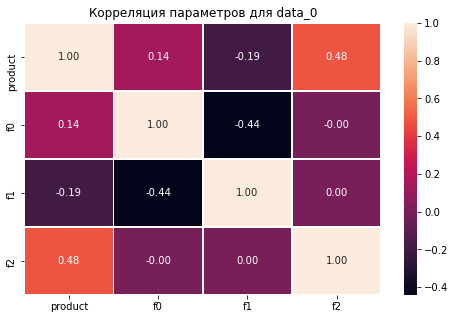

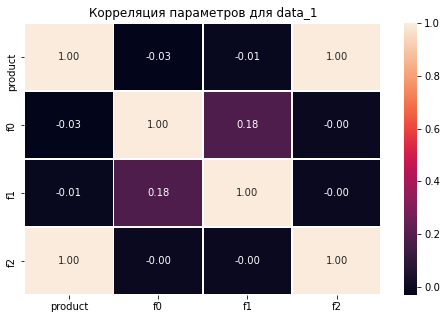

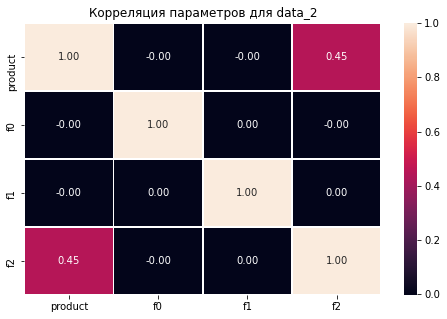

In [20]:
_ = 0
for df in [data_0, data_1, data_2]:    
    sns.heatmap(data=df[['product', 'f0', 'f1', 'f2']].corr(),
        annot=True, fmt='0.2f', linewidths=.8
    )
    plt.title('Корреляция параметров для data_{}'.format(_))
    plt.show()
    _ += 1

In [21]:
px.scatter_matrix(data_1[['product', 'f0', 'f1', 'f2']],
                 title="Распределение величин для data_1")

In [22]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=data_0['product'], histnorm='probability density', name='Регион 0'))
fig.add_trace(go.Histogram(x=data_1['product'], histnorm='probability density', name='Регион 1'))
fig.add_trace(go.Histogram(x=data_2['product'], histnorm='probability density', name='Регион 2'))
fig.update_layout(
    title="Распределение 'product'",
    xaxis_title="product",
    yaxis_title="Плотность вероятности",
    )

fig.show()

## 1.3. Разделим выбоки для обучения модели

In [23]:
numeric_features = ['f0', 'f1', 'f2']
X_0, y_0 = data_0[numeric_features], data_0['product']
X_1, y_1 = data_1[numeric_features], data_1['product']
X_2, y_2 = data_2[numeric_features], data_2['product']

In [24]:
X_0_train, X_0_valid, y_0_train, y_0_valid = train_test_split(X_0, y_0, test_size=.25, random_state=0)
X_1_train, X_1_valid, y_1_train, y_1_valid = train_test_split(X_1, y_1, test_size=.25, random_state=0)
X_2_train, X_2_valid, y_2_train, y_2_valid = train_test_split(X_2, y_2, test_size=.25, random_state=0)

In [25]:
_ = 0
for samp_X_tr, samp_X_v, samp_y_tr, samp_y_v  in [[X_0_train, X_0_valid, y_0_train, y_0_valid], 
                                                  [X_1_train, X_1_valid, y_1_train, y_1_valid],
                                                  [X_2_train, X_2_valid, y_2_train, y_2_valid]
                                                 ]:
    print('Размер тренировочной выборки для региона {}: X = {}, y = {}'.format(_, samp_X_tr.shape, samp_y_tr.shape))
    print('Размер валидационной выборки для региона {}: X = {}, y = {}\n'.format(_, samp_X_v.shape, samp_y_v.shape))
    _ += 1
    
del samp_X_tr, samp_X_v, samp_y_tr, samp_y_v

Размер тренировочной выборки для региона 0: X = (75000, 3), y = (75000,)
Размер валидационной выборки для региона 0: X = (25000, 3), y = (25000,)

Размер тренировочной выборки для региона 1: X = (75000, 3), y = (75000,)
Размер валидационной выборки для региона 1: X = (25000, 3), y = (25000,)

Размер тренировочной выборки для региона 2: X = (75000, 3), y = (75000,)
Размер валидационной выборки для региона 2: X = (25000, 3), y = (25000,)



## 1.4. Произведем масштабирование параметров

In [26]:
pd.options.display.float_format = '{:.2f}'.format
_ = 0
for samp_X_tr, samp_X_v in [[X_0_train, X_0_valid],
                            [X_1_train, X_1_valid],
                            [X_2_train, X_2_valid]
                           ]:
    scaler = StandardScaler()
    scaler.fit(samp_X_tr[numeric_features])
    samp_X_tr[numeric_features] = scaler.transform(samp_X_tr[numeric_features])
    samp_X_v[numeric_features] = scaler.transform(samp_X_v[numeric_features])
    print("Describe для тренировочной выборки региона {}".format(_))
    display(samp_X_tr.describe()['mean':'std'])
    print("Describe для валидационной выборки региона {}".format(_))
    display(samp_X_v.describe()['mean':'std'])
    print('________________________________________')
    print('________________________________________')
    _ += 1
del samp_X_tr, samp_X_v

Describe для тренировочной выборки региона 0


,f0,f1,f2
mean,-0.00,-0.00,0.00
std,1.00,1.00,1.00


Describe для валидационной выборки региона 0


,f0,f1,f2
mean,-0.01,0.01,-0.01
std,1.00,1.00,1.00


________________________________________
________________________________________
Describe для тренировочной выборки региона 1


,f0,f1,f2
mean,-0.00,0.00,-0.00
std,1.00,1.00,1.00


Describe для валидационной выборки региона 1


,f0,f1,f2
mean,-0.01,-0.01,0.01
std,1.00,1.00,1.00


________________________________________
________________________________________
Describe для тренировочной выборки региона 2


,f0,f1,f2
mean,-0.00,0.00,0.00
std,1.00,1.00,1.00


Describe для валидационной выборки региона 2


,f0,f1,f2
mean,-0.00,-0.02,-0.01
std,1.01,1.00,1.00


________________________________________
________________________________________


## Вывод

1. Данные не содержат пропусков и дубликатов
2. Присутствуют повторяющиеся значения в столбцах `'id'` для некоторых регионов.
3. Наблюдается линейная зависимость для признаков `'f2'` и `'production'` в датасете `data_1`.
4. При построении парного скатерплота видно, что небольшие различия все же имеются между вышеуказанными признаками, при дальнейшем построении модели будем учитывать наличие линейной зависимости, на данный момент дополнительной обработки производить не будем.
5. Для каждого региона произвели разделение на тренировочную и валидационную выборки в соотношении 75 : 25.
6. Произвели мастабирование количественных признаков по модели тренировочной выборки.
7. Данные готовы можно переходить к обучению моделей.

# 2. Обучение и проверка модели

In [27]:
def fit_model(X_t, y_t, X_v, y_v, title='region'):
    model = LinearRegression()
    model.fit(X_t, y_t)
    print('R^2 для модели региона {} = {:5f}'.format(title, model.score(X_t, y_t)))
    MSE = mean_squared_error(y_v, model.predict(X_v))
    RMSE = MSE ** .5
    prediction = model.predict(X_v) #Комментарий наставника: можно было сначала получить предсказания, а потом уже оценивать модель по ним
    print('Фактический средний запас в регионe {} = {:5f}'.format(title, y_v.mean()))
    print('Предсказанный средний запас в регионe {} = {:5f}'.format(title, np.mean(prediction)))
    print('RMSE для модели региона {} = {:5f}'.format(title, RMSE))
    sanity_check = pd.Series([y_t.mean() for i in range(len(y_v))])
    print('Проверка на вменяемость', mean_squared_error(y_v, sanity_check)**.5)
    
    return model, prediction, RMSE

In [28]:
model_0, prediction_0, RMSE_0 = fit_model(X_0_train, y_0_train, X_0_valid, y_0_valid, '0')

R^2 для модели региона 0 = 0.273971
Фактический средний запас в регионe 0 = 92.466785
Предсказанный средний запас в регионe 0 = 92.271449
RMSE для модели региона 0 = 37.481009
Проверка на вменяемость 44.2002575290731


In [29]:
model_1, prediction_1, RMSE_1 = fit_model(X_1_train, y_1_train, X_1_valid, y_1_valid, '1')

R^2 для модели региона 1 = 0.999624
Фактический средний запас в регионe 1 = 69.154361
Предсказанный средний запас в регионe 1 = 69.151624
RMSE для модели региона 1 = 0.887257
Проверка на вменяемость 45.95381663563699


In [30]:
model_2, prediction_2, RMSE_2 = fit_model(X_2_train, y_2_train, X_2_valid, y_2_valid, '2')

R^2 для модели региона 2 = 0.200214
Фактический средний запас в регионe 2 = 95.471317
Предсказанный средний запас в регионe 2 = 94.707531
RMSE для модели региона 2 = 40.312907
Проверка на вменяемость 44.91822496612704


In [31]:
#Проверим R^2 для модели при помощи кросс валидации
np.mean(cross_val_score(LinearRegression(), X_0_train, y_0_train, cv=5))#Отклонение близкО к результатам без CV

0.27378151831507197

## Вывод

1. Произвели обучение моделей по 3-м регионам.
2. Лучший результат показала модель для региона_1, тут сказывается линейная зависимость между признаком `'f2'` и целевым признаком.
3. Наименьшая ошибка для региона_1 составила RMSE=0.887257.
4. Для каждой модели была произведена проверка на вменяемость, которая показала не сильно большое отличие между результатами моделей для региона_0 и региона_2 (разница составила 7 и 5)
5. Значительное отличие при проверке на вменяемость наблюдается для модели региона_1
6. Среднее значение запасов все модели предсказывают достаточно точно отклонение от фактического составляет не более 0,8%

# 3. Подготовка к расчёту прибыли

In [32]:
NUMBER_OF_WELLS      = 500
NUMBER_OF_BEST_WELLS = 200
BUDGET               = 10*10**9
BARREL_PRICE         = 450*10**3
SUCCESS_BORDER       = .025

In [33]:
print('Минимальный объем нефти для безубыточной разработки составляет: {:0.2f} тыс.баррелей'.format(BUDGET / BARREL_PRICE))
print('Средний объем нефти с одной скважины для безубыточной разработки составляет: {:0.2f} тыс.баррелей'\
      .format(BUDGET / BARREL_PRICE / NUMBER_OF_BEST_WELLS))

Минимальный объем нефти для безубыточной разработки составляет: 22222.22 тыс.баррелей
Средний объем нефти с одной скважины для безубыточной разработки составляет: 111.11 тыс.баррелей


In [34]:
def revenue_calculate (target, pred, count, title=None):
    pred = pd.Series(pred, index=target.index)
    pred_sorted = pred.sort_values(ascending=False)
    selected = target[pred_sorted.index][:count]
    income = BARREL_PRICE * selected.sum()
    profit = income - BUDGET

    return profit, selected

Посчитаем максимальный доход среди топ-200 среди всего региона

In [35]:
_ = 0

for tar, pred in [
            [y_0_valid, prediction_0],
            [y_1_valid, prediction_1], 
            [y_2_valid, prediction_2]
        ]:
            print('Регион_{}:'.format(_))
        
            profit_max_from_region, selected_wells = revenue_calculate(tar, pred, NUMBER_OF_BEST_WELLS, _)

            
            print('Максимальный доход в регионе составляет {:.0f} руб.'.format(profit_max_from_region))
            print('Максимальный запас нефти в топ-{} скважин составляет {:.0f} тыс.баррелей'\
                  .format(NUMBER_OF_BEST_WELLS, selected_wells.sum()))
            print('Максимальный средний запас нефти в топ-{} скважинах составляет {:.0f} тыс.баррелей'\
                  .format(NUMBER_OF_BEST_WELLS, selected_wells.mean()))
            print()
            
            _ +=1

Регион_0:
Максимальный доход в регионе составляет 3363408080 руб.
Максимальный запас нефти в топ-200 скважин составляет 29696 тыс.баррелей
Максимальный средний запас нефти в топ-200 скважинах составляет 148 тыс.баррелей

Регион_1:
Максимальный доход в регионе составляет 2415086697 руб.
Максимальный запас нефти в топ-200 скважин составляет 27589 тыс.баррелей
Максимальный средний запас нефти в топ-200 скважинах составляет 138 тыс.баррелей

Регион_2:
Максимальный доход в регионе составляет 2623878684 руб.
Максимальный запас нефти в топ-200 скважин составляет 28053 тыс.баррелей
Максимальный средний запас нефти в топ-200 скважинах составляет 140 тыс.баррелей



# 4. Расчёт прибыли и рисков 

Произведем расчет прибыли

In [36]:
_ = 0
mean_profit = {
    'Регион_0' : [],
    'Регион_1' : [],
    'Регион_2' : []
}

reg_key_list = []
for k in mean_profit:
    reg_key_list.append(k)
    
state = np.random.RandomState(100500)

for tar, pred in [
            [y_0_valid, prediction_0],
            [y_1_valid, prediction_1], 
            [y_2_valid, prediction_2]
        ]:
    profit = []
    oil_reverse = []
    for i in range(1000):
        predict = pd.Series(pred, index=tar.index)
        target_subsample = tar.sample(n=NUMBER_OF_WELLS, replace=True, random_state=state)
        probs_subsample  = predict[target_subsample.index]
        profit_from_wells, average_oil_reverse = revenue_calculate(target_subsample,
                                                                   probs_subsample,
                                                                   NUMBER_OF_BEST_WELLS)
        profit.append(profit_from_wells)
        oil_reverse.append(average_oil_reverse.mean())
        
    profit       = pd.Series(profit)
    oil_reverse  = pd.Series(oil_reverse)
    
    print('Регион_{}'.format(_))
    print('Средний доход в регионе исходя из стоимости нефти {:.0f} за тыс.баррелей соствалят: {:.0f}'\
          .format(BARREL_PRICE/1000, profit.mean()))
    print('Средний запас нефти в топ-{} скважинах из выборок по {} скважин составляет : {:.0f}'\
          .format(NUMBER_OF_BEST_WELLS, NUMBER_OF_WELLS, oil_reverse.mean()))
    print('Общий запас нефти в топ-{} скважинах из выборок по {} скважин составляет : {:.0f}'\
      .format(NUMBER_OF_BEST_WELLS, NUMBER_OF_WELLS, oil_reverse.sum()))
    
    for persent in np.arange(10, 0, -.1):
        lower =  profit.quantile(persent/100)
        if lower < 0:
            probab_of_fail = persent
            break
        else: probab_of_fail = 'значение близкое к нулю'
        
    print('Вероятность убытка при разработке региона составляет {:.2f}%'.format(probab_of_fail))
    print()
    
    mean_profit[reg_key_list[_]].append(profit.mean())
    mean_profit[reg_key_list[_]].append(oil_reverse.mean())
    mean_profit[reg_key_list[_]].append(probab_of_fail)
    mean_profit[reg_key_list[_]].append(profit)
    mean_profit[reg_key_list[_]].append(oil_reverse)
    
    _ += 1

Регион_0
Средний доход в регионе исходя из стоимости нефти 450 за тыс.баррелей соствалят: 475455243
Средний запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 116
Общий запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 116394
Вероятность убытка при разработке региона составляет 4.70%

Регион_1
Средний доход в регионе исходя из стоимости нефти 450 за тыс.баррелей соствалят: 525973144
Средний запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 117
Общий запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 116955
Вероятность убытка при разработке региона составляет 0.70%

Регион_2
Средний доход в регионе исходя из стоимости нефти 450 за тыс.баррелей соствалят: 423245778
Средний запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 116
Общий запас нефти в топ-200 скважинах из выборок по 500 скважин составляет : 115814
Вероятность убытка при разработке региона составляет 5.20%



In [37]:
x = np.arange(0, 100.1, .1)
def figures_of_quantele(x, series):
    return series.quantile(x/100)

In [38]:
fig = go.Figure()

fig.update_yaxes(range=[-10**9, 1.5*10**9], zeroline=True, zerolinewidth=2, zerolinecolor='LightPink')


fig.add_trace(go.Scatter(x=x, y=figures_of_quantele(x, mean_profit['Регион_0'][3]), name='Регион 0'))
fig.add_trace(go.Scatter(x=x, y=figures_of_quantele(x, mean_profit['Регион_1'][3]), name='Регион 1'))
fig.add_trace(go.Scatter(x=x, y=figures_of_quantele(x, mean_profit['Регион_2'][3]), name='Регион 2'))

fig.update_layout(legend_orientation="h",
                  legend=dict(x=.2, xanchor="center"),
                  title="Риск получения дохода не выше указанного уровня",
                  xaxis_title="Вероятность",
                  yaxis_title="Уровень дохода",
                  hovermode="x",
                  margin=dict(l=0, r=50, t=50, b=50))
fig.show()

1. Как видно из графика с вероятностью 76% средний доход при разработке в регионе_1 составит большее значение чем в двух других регионах
2. Вероятность убытка в регионе составит не более 0.7%
3. В двух других регионах вероятность убытка выше чем 2,5%
4. Таким образом для разработки наиболее рационально рассматривать регион_1

In [39]:
profit_in_best_region      = mean_profit['Регион_1'][3] / 10**6
oil_reverse_in_best_region = mean_profit['Регион_1'][4]

profit_confidence_interval = st.t.interval(0.95, len(profit_in_best_region)-1, 
                                    profit_in_best_region.mean(), 
                                    profit_in_best_region.sem())
oil_confidence_interval = st.t.interval(0.95, len(oil_reverse_in_best_region)-1, 
                                    oil_reverse_in_best_region.mean(), 
                                    oil_reverse_in_best_region.sem())
print('Доверительный интервал среднего дохода составляет от {:.2f} млн.руб до {:.2f} млн.руб'\
      .format(*(profit_confidence_interval)))
print('Доверительный интервал среднего объема нефти составляет от {:.2f} тыс.баррелей до {:.2f} тыс.баррелей'\
      .format(*(oil_confidence_interval)))

Доверительный интервал среднего дохода составляет от 512.83 млн.руб до 539.12 млн.руб
Доверительный интервал среднего объема нефти составляет от 116.81 тыс.баррелей до 117.10 тыс.баррелей


## Вывод

1. Наиболее перспективный регион - Регион_1;
2. Среднее значение дохода с 95-ти процентной вероятностью составит от 512.83 млн.руб до 539.12 млн.руб
3. Средний объем нефти с 95-ти процентной вероятностью составляет от 116.81 тыс.баррелей до 117.10 тыс.баррелей
4. Вероятность риска убыкта составляет не более 0.7%